## DCGAN on LSUN Bedroom Dataset

The original LSUN dataset contains 3 million images. Trying to load the entire dataset was causing errors due to insufficient storage space. So we decided to train the model on 2 smaller datasets on the LSUN bedroom images. We first ran the code on a dataset of 19,811 bedroom images. Once that was running, we ran the model on a dataset of 303125 images (10% of the original LSUN dataset).

In [6]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 
from numpy import zeros, ones 
import numpy as np
from numpy.random import randn, randint
import tensorflow as tf
from matplotlib import pyplot as plt
from model.dcgan_lsun import discriminator_, generator_, dcgan_
from utils.dataset_utils import return_cifar10 
from utils.model_utils import true_samples_generator, fake_samples_generator, make_latent_samples
from utils.visualizers_utils import show_generated_images, performance_summarizer
from tqdm.notebook import tqdm
from utils.visualizers_utils import show_gan_losses
import imageio
from glob import glob
import re
from utils.visualizers_utils import generate_video 
from utils.image_utils import preprocess_image, scaleback_image, image_loader

## Training on dataset with 19,811 images

Number of images in the train set:  19811
shape of each image is : (64, 64, 3)
********************
Original Images
********************


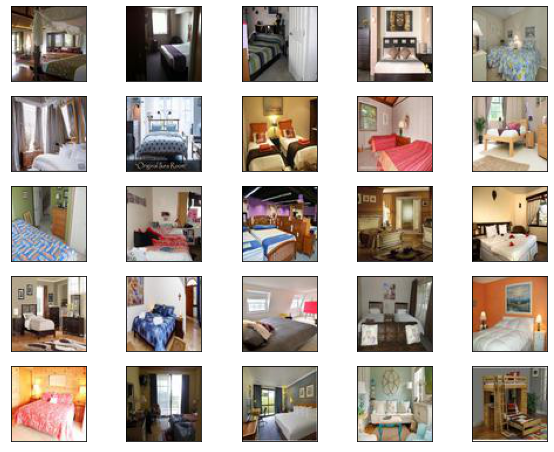

********************
After cropping & Reshaping
********************


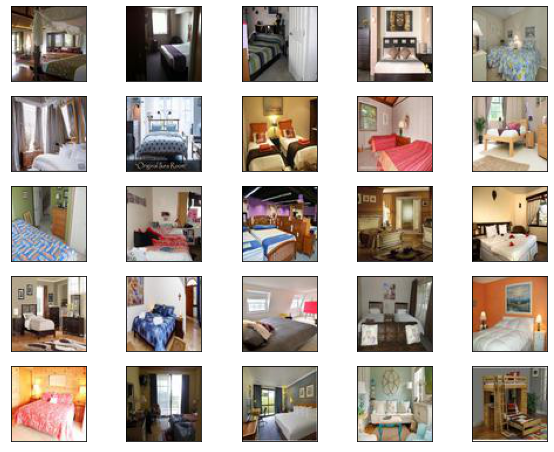

shape after cropping:  (64, 64, 3)


In [9]:
# LOADING DATA
X_train = np.array(glob('data/lsun_imgs/*.jpg'))
print("Number of images in the train set: ", X_train.shape[0])
print("shape of each image is :", plt.imread(X_train[0]).shape)

print('*'*20)
print("Original Images")
print('*'*20)
plt.figure(figsize=(10, 8))
for i in range(25):
    image = plt.imread(X_train[i])
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(image)

plt.show()

print('*'*20)
print("After cropping & Reshaping")
print('*'*20)

plt.figure(figsize=(10, 8))
for i in range(25):
    image = image_loader(X_train[i], resize_to=(64, 64))
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(image)
plt.show()
print("shape after cropping: ", image.shape)





In [2]:
# train the generator and discriminator
def train(generator, discriminator, dcgan, data, samplesize, epochs=200, batch_size=128, model_name=None):
    print(f' Training {model_name} ......')
    num_batches = int(data.shape[0] / batch_size)
    half_batch = int(batch_size / 2)

    discriminator_losses = []
    generator_losses = [] 
    # manually enumerate epochs
    for epoch in tqdm(range(epochs)):
        generator_loss_epoch = 0 
        discriminator_loss_epoch = 0 

        # enumerate batches over the training set
        for batch in tqdm(range(num_batches)):
            X_batch = X_train[batch*batch_size:(batch+1)*batch_size] #gets the file names 
            X_batch_real = np.array([(image_loader(file_, resize_to=(64,64))) for file_ in X_batch]) #get the images in the np format 
            
            X_batch_real =  X_batch_real.astype('float32')
            X_batch_real = (X_batch_real-127.5)/127.5
    
            # get randomly selected 'real' samples
            X_real, y_real = true_samples_generator(X_batch_real, half_batch)
            # update discriminator model weights
            discriminator_real_loss, _ = discriminator.train_on_batch(X_real, y_real)
            # generate 'fake' examples
            X_fake, y_fake = fake_samples_generator(half_batch, samplesize, generator)
            # update discriminator model weights
            discriminator_fake_loss, _ = discriminator.train_on_batch(X_fake, y_fake)
            # prepare points in latent space as input for the generator
            X_gan = make_latent_samples( samplesize, batch_size)
            # create inverted labels for the fake samples
            y_gan = np.ones((batch_size, 1))
            # update the generator via the discriminator's error
            generator_loss = dcgan.train_on_batch(X_gan, y_gan)

            #update the losses
            discriminator_loss_epoch += (discriminator_real_loss + discriminator_fake_loss)
            generator_loss_epoch += (generator_loss)

            # summarize loss on this batch
            if batch % 100 == 0:
                print(f' Epoch: {epoch + 1}, Batch: {batch + 1} of {num_batches}')
                print(f' Discriminator real loss: {discriminator_real_loss}, Discriminator Fake loss: {discriminator_fake_loss}, Generator loss: {generator_loss}')

        discriminator_losses.append(discriminator_loss_epoch)
        generator_losses.append(generator_loss_epoch)
        performance_summarizer(epoch, generator, discriminator, X_batch_real, samplesize, model_name=model_name)
    show_gan_losses(generator_losses, discriminator_losses, save_to= f'results/{model_name}/')
    print("Done with training the model ......")
    return generator

 Training DCGAN_lsun_nobn_300k ......


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 1, Batch: 1 of 2368
 Discriminator real loss: 0.6741783022880554, Discriminator Fake loss: 0.6986382603645325, Generator loss: 0.6884521245956421
 Epoch: 1, Batch: 101 of 2368
 Discriminator real loss: 1.2475355863571167, Discriminator Fake loss: 0.010045843198895454, Generator loss: 2.802497625350952
 Epoch: 1, Batch: 201 of 2368
 Discriminator real loss: 0.5653635859489441, Discriminator Fake loss: 0.0008165749022737145, Generator loss: 7.180119037628174
 Epoch: 1, Batch: 301 of 2368
 Discriminator real loss: 0.08209235966205597, Discriminator Fake loss: 0.03912981227040291, Generator loss: 4.2377705574035645
 Epoch: 1, Batch: 401 of 2368
 Discriminator real loss: 0.05943099409341812, Discriminator Fake loss: 0.036780137568712234, Generator loss: 4.347740173339844
 Epoch: 1, Batch: 501 of 2368
 Discriminator real loss: 0.19711296260356903, Discriminator Fake loss: 0.17953377962112427, Generator loss: 3.416651725769043
 Epoch: 1, Batch: 601 of 2368
 Discriminator real loss: 0.

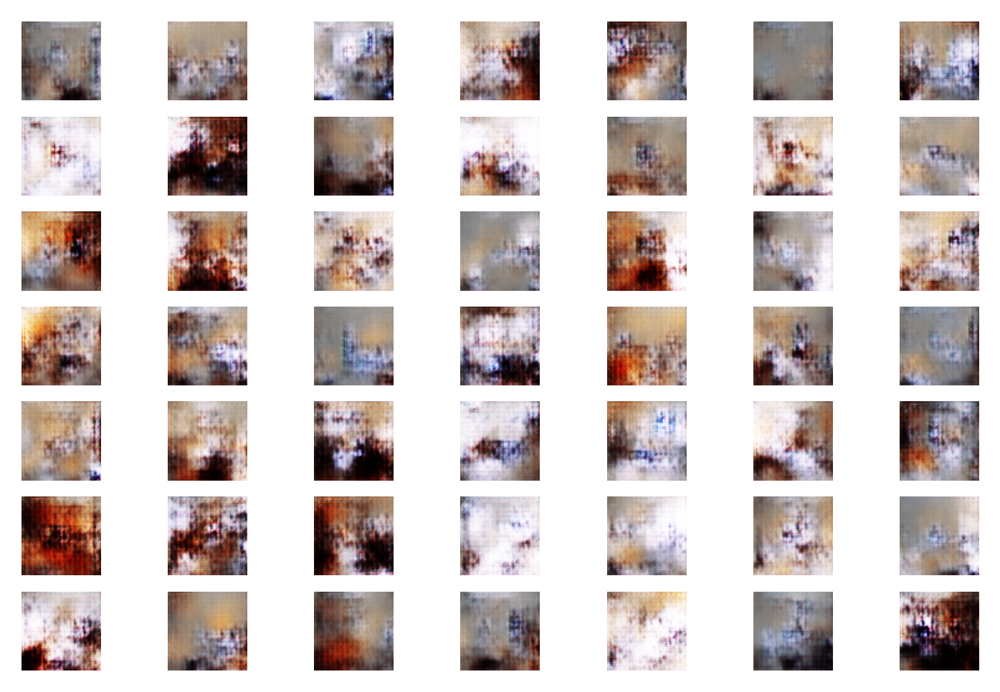

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 2, Batch: 1 of 2368
 Discriminator real loss: 0.17267408967018127, Discriminator Fake loss: 0.16081005334854126, Generator loss: 4.456908226013184
 Epoch: 2, Batch: 101 of 2368
 Discriminator real loss: 0.12637123465538025, Discriminator Fake loss: 0.14565978944301605, Generator loss: 3.6041204929351807
 Epoch: 2, Batch: 201 of 2368
 Discriminator real loss: 0.600265622138977, Discriminator Fake loss: 0.2637287974357605, Generator loss: 4.174864768981934
 Epoch: 2, Batch: 301 of 2368
 Discriminator real loss: 0.16591407358646393, Discriminator Fake loss: 0.23614031076431274, Generator loss: 4.124912261962891
 Epoch: 2, Batch: 401 of 2368
 Discriminator real loss: 0.20387300848960876, Discriminator Fake loss: 0.13860169053077698, Generator loss: 4.17119026184082
 Epoch: 2, Batch: 501 of 2368
 Discriminator real loss: 0.6258427500724792, Discriminator Fake loss: 0.8162753582000732, Generator loss: 6.0639190673828125
 Epoch: 2, Batch: 601 of 2368
 Discriminator real loss: 0.199745

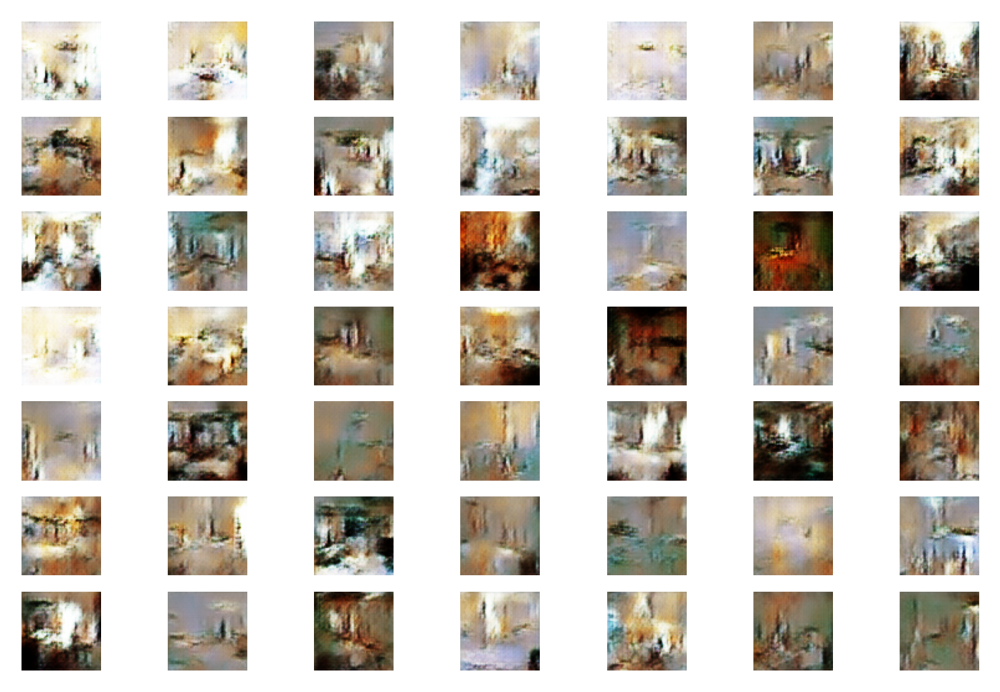

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 3, Batch: 1 of 2368
 Discriminator real loss: 0.09824766963720322, Discriminator Fake loss: 0.10236182808876038, Generator loss: 4.347622394561768
 Epoch: 3, Batch: 101 of 2368
 Discriminator real loss: 0.25756651163101196, Discriminator Fake loss: 0.07583701610565186, Generator loss: 3.915492057800293
 Epoch: 3, Batch: 201 of 2368
 Discriminator real loss: 0.2493533492088318, Discriminator Fake loss: 0.266734778881073, Generator loss: 5.100996971130371
 Epoch: 3, Batch: 301 of 2368
 Discriminator real loss: 0.27513834834098816, Discriminator Fake loss: 0.07085727900266647, Generator loss: 4.384099006652832
 Epoch: 3, Batch: 401 of 2368
 Discriminator real loss: 0.21502074599266052, Discriminator Fake loss: 0.1495649516582489, Generator loss: 4.0620832443237305
 Epoch: 3, Batch: 501 of 2368
 Discriminator real loss: 0.2395777404308319, Discriminator Fake loss: 0.22904251515865326, Generator loss: 3.916121006011963
 Epoch: 3, Batch: 601 of 2368
 Discriminator real loss: 0.178933

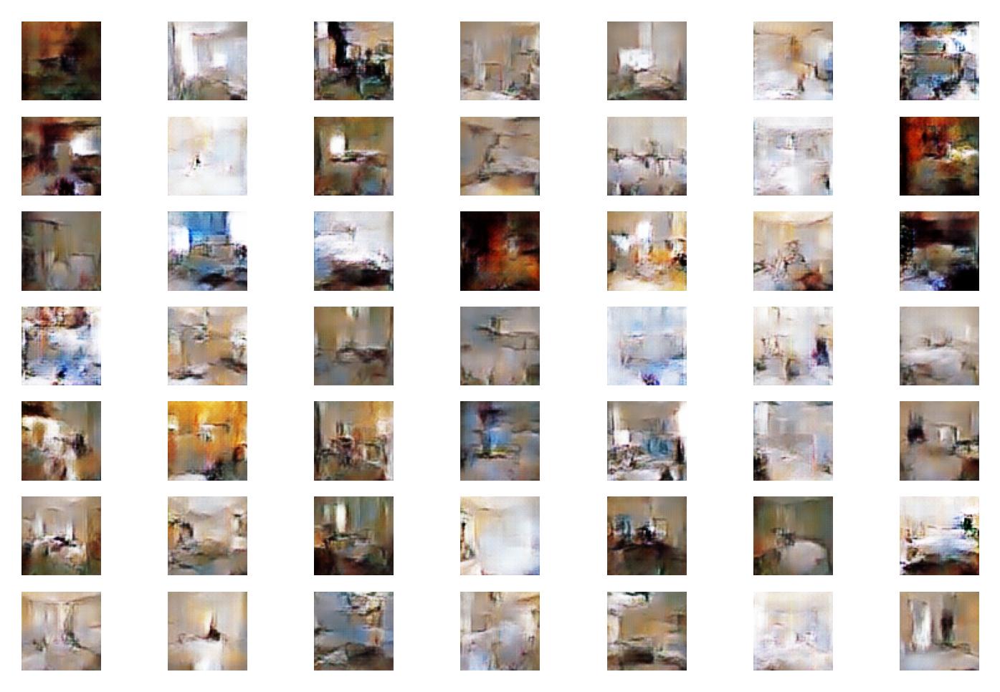

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 4, Batch: 1 of 2368
 Discriminator real loss: 0.1985601931810379, Discriminator Fake loss: 0.16312208771705627, Generator loss: 3.711075782775879
 Epoch: 4, Batch: 101 of 2368
 Discriminator real loss: 0.2995717525482178, Discriminator Fake loss: 0.16109801828861237, Generator loss: 4.1469621658325195
 Epoch: 4, Batch: 201 of 2368
 Discriminator real loss: 0.2630927562713623, Discriminator Fake loss: 0.19329361617565155, Generator loss: 3.3831257820129395
 Epoch: 4, Batch: 301 of 2368
 Discriminator real loss: 0.16629767417907715, Discriminator Fake loss: 0.24295465648174286, Generator loss: 3.7613234519958496
 Epoch: 4, Batch: 401 of 2368
 Discriminator real loss: 0.41966673731803894, Discriminator Fake loss: 0.35814112424850464, Generator loss: 3.9946932792663574
 Epoch: 4, Batch: 501 of 2368
 Discriminator real loss: 0.15690195560455322, Discriminator Fake loss: 0.31208890676498413, Generator loss: 5.06187629699707
 Epoch: 4, Batch: 601 of 2368
 Discriminator real loss: 0.41

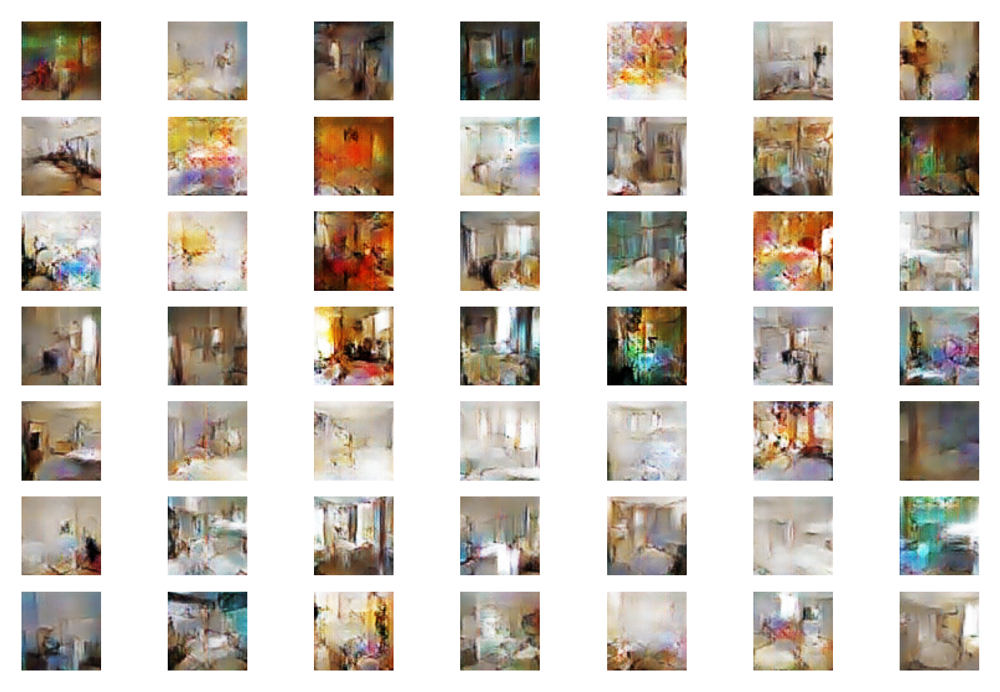

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 5, Batch: 1 of 2368
 Discriminator real loss: 0.15163488686084747, Discriminator Fake loss: 0.14975565671920776, Generator loss: 3.576215982437134
 Epoch: 5, Batch: 101 of 2368
 Discriminator real loss: 0.29475924372673035, Discriminator Fake loss: 0.0875653326511383, Generator loss: 3.601227283477783
 Epoch: 5, Batch: 201 of 2368
 Discriminator real loss: 0.12351184338331223, Discriminator Fake loss: 0.2608289122581482, Generator loss: 4.265572547912598
 Epoch: 5, Batch: 301 of 2368
 Discriminator real loss: 0.35666143894195557, Discriminator Fake loss: 0.16929730772972107, Generator loss: 3.497354507446289
 Epoch: 5, Batch: 401 of 2368
 Discriminator real loss: 0.28159546852111816, Discriminator Fake loss: 0.22442390024662018, Generator loss: 3.564054489135742
 Epoch: 5, Batch: 501 of 2368
 Discriminator real loss: 0.28935790061950684, Discriminator Fake loss: 0.2747577428817749, Generator loss: 3.769247531890869
 Epoch: 5, Batch: 601 of 2368
 Discriminator real loss: 0.27125

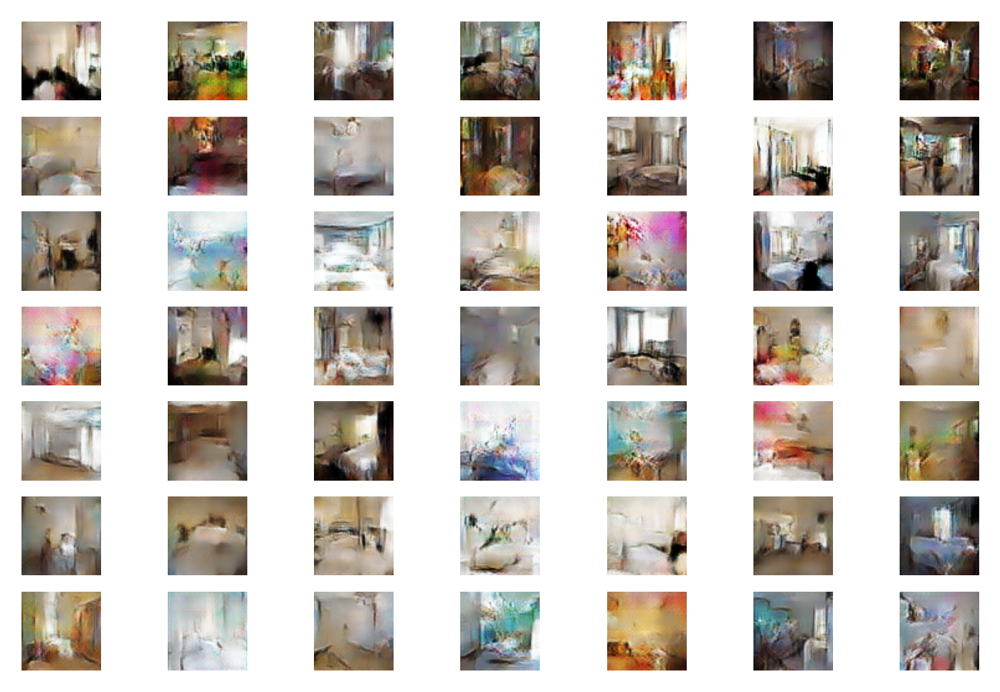

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 6, Batch: 1 of 2368
 Discriminator real loss: 0.1696365624666214, Discriminator Fake loss: 0.5013004541397095, Generator loss: 3.769857168197632
 Epoch: 6, Batch: 101 of 2368
 Discriminator real loss: 0.41758304834365845, Discriminator Fake loss: 0.14526255428791046, Generator loss: 3.241096019744873
 Epoch: 6, Batch: 201 of 2368
 Discriminator real loss: 0.40624457597732544, Discriminator Fake loss: 0.3745059669017792, Generator loss: 3.059451103210449
 Epoch: 6, Batch: 301 of 2368
 Discriminator real loss: 0.3454340100288391, Discriminator Fake loss: 0.2226722240447998, Generator loss: 3.3239431381225586
 Epoch: 6, Batch: 401 of 2368
 Discriminator real loss: 0.2537994086742401, Discriminator Fake loss: 0.11447162926197052, Generator loss: 3.649883270263672
 Epoch: 6, Batch: 501 of 2368
 Discriminator real loss: 0.2745361328125, Discriminator Fake loss: 0.2525656223297119, Generator loss: 3.9111487865448
 Epoch: 6, Batch: 601 of 2368
 Discriminator real loss: 0.31807100772857

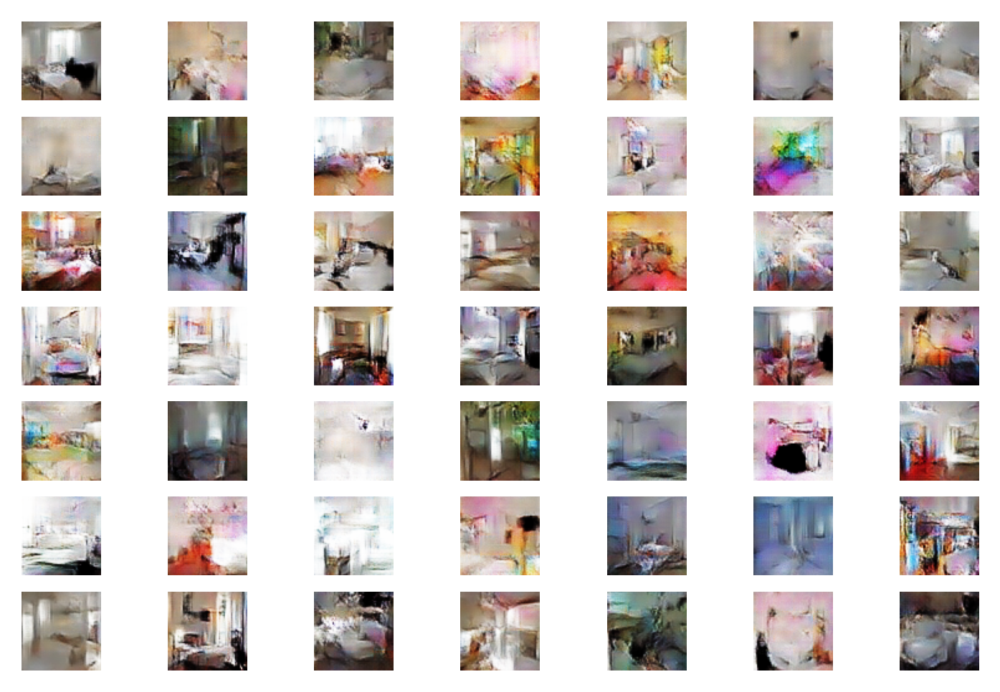

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 7, Batch: 1 of 2368
 Discriminator real loss: 0.1003638505935669, Discriminator Fake loss: 0.10523967444896698, Generator loss: 3.6165106296539307
 Epoch: 7, Batch: 101 of 2368
 Discriminator real loss: 0.38110843300819397, Discriminator Fake loss: 0.2622183561325073, Generator loss: 2.7828969955444336
 Epoch: 7, Batch: 201 of 2368
 Discriminator real loss: 0.3935653567314148, Discriminator Fake loss: 0.22767183184623718, Generator loss: 3.105401039123535
 Epoch: 7, Batch: 301 of 2368
 Discriminator real loss: 0.1780078411102295, Discriminator Fake loss: 0.1337251365184784, Generator loss: 3.7559304237365723
 Epoch: 7, Batch: 401 of 2368
 Discriminator real loss: 0.21262681484222412, Discriminator Fake loss: 0.16713446378707886, Generator loss: 3.613027572631836
 Epoch: 7, Batch: 501 of 2368
 Discriminator real loss: 0.24180608987808228, Discriminator Fake loss: 0.16866827011108398, Generator loss: 3.262641191482544
 Epoch: 7, Batch: 601 of 2368
 Discriminator real loss: 0.2841

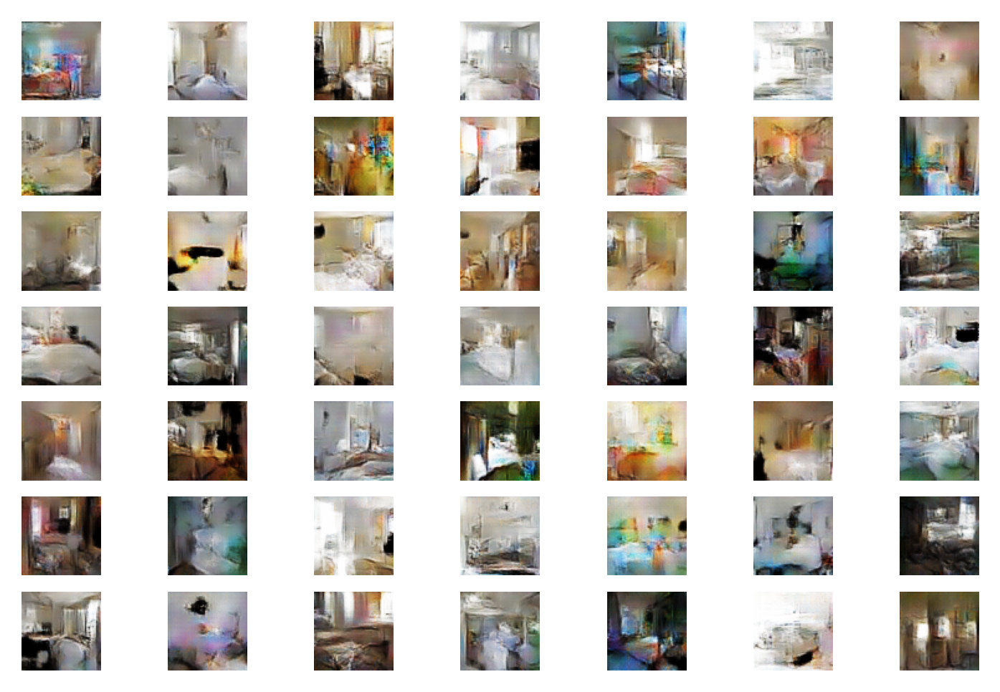

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 8, Batch: 1 of 2368
 Discriminator real loss: 0.1825079321861267, Discriminator Fake loss: 0.16609059274196625, Generator loss: 3.2176971435546875
 Epoch: 8, Batch: 101 of 2368
 Discriminator real loss: 0.12222638726234436, Discriminator Fake loss: 0.16923874616622925, Generator loss: 3.8439064025878906
 Epoch: 8, Batch: 201 of 2368
 Discriminator real loss: 0.48630717396736145, Discriminator Fake loss: 0.20641349256038666, Generator loss: 3.459196090698242
 Epoch: 8, Batch: 301 of 2368
 Discriminator real loss: 0.16299766302108765, Discriminator Fake loss: 0.17066359519958496, Generator loss: 3.7807517051696777
 Epoch: 8, Batch: 401 of 2368
 Discriminator real loss: 0.34960171580314636, Discriminator Fake loss: 0.15170058608055115, Generator loss: 3.591362953186035
 Epoch: 8, Batch: 501 of 2368
 Discriminator real loss: 0.28034061193466187, Discriminator Fake loss: 0.16246996819972992, Generator loss: 3.757828712463379
 Epoch: 8, Batch: 601 of 2368
 Discriminator real loss: 0.

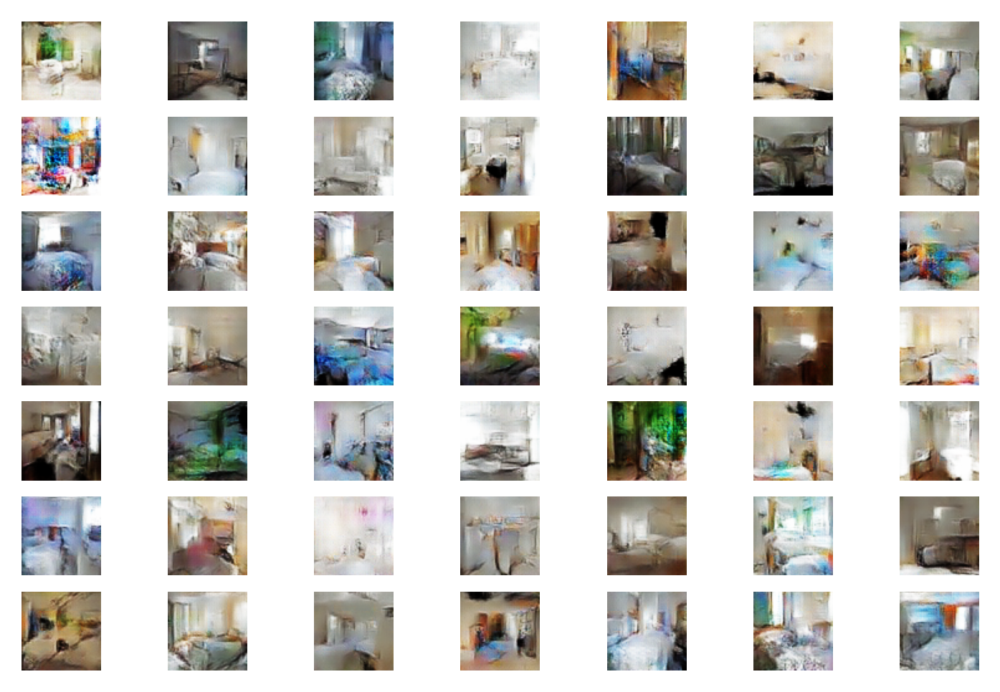

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 9, Batch: 1 of 2368
 Discriminator real loss: 0.1345260590314865, Discriminator Fake loss: 0.12664639949798584, Generator loss: 2.9521031379699707
 Epoch: 9, Batch: 101 of 2368
 Discriminator real loss: 0.23936042189598083, Discriminator Fake loss: 0.10689130425453186, Generator loss: 3.26527738571167
 Epoch: 9, Batch: 201 of 2368
 Discriminator real loss: 0.21918821334838867, Discriminator Fake loss: 0.26043736934661865, Generator loss: 4.187618732452393
 Epoch: 9, Batch: 301 of 2368
 Discriminator real loss: 0.2501208782196045, Discriminator Fake loss: 0.1590813845396042, Generator loss: 3.4647960662841797
 Epoch: 9, Batch: 401 of 2368
 Discriminator real loss: 0.2423250824213028, Discriminator Fake loss: 0.3811286985874176, Generator loss: 3.924677848815918
 Epoch: 9, Batch: 501 of 2368
 Discriminator real loss: 0.42486312985420227, Discriminator Fake loss: 0.25413912534713745, Generator loss: 4.138388156890869
 Epoch: 9, Batch: 601 of 2368
 Discriminator real loss: 0.178746

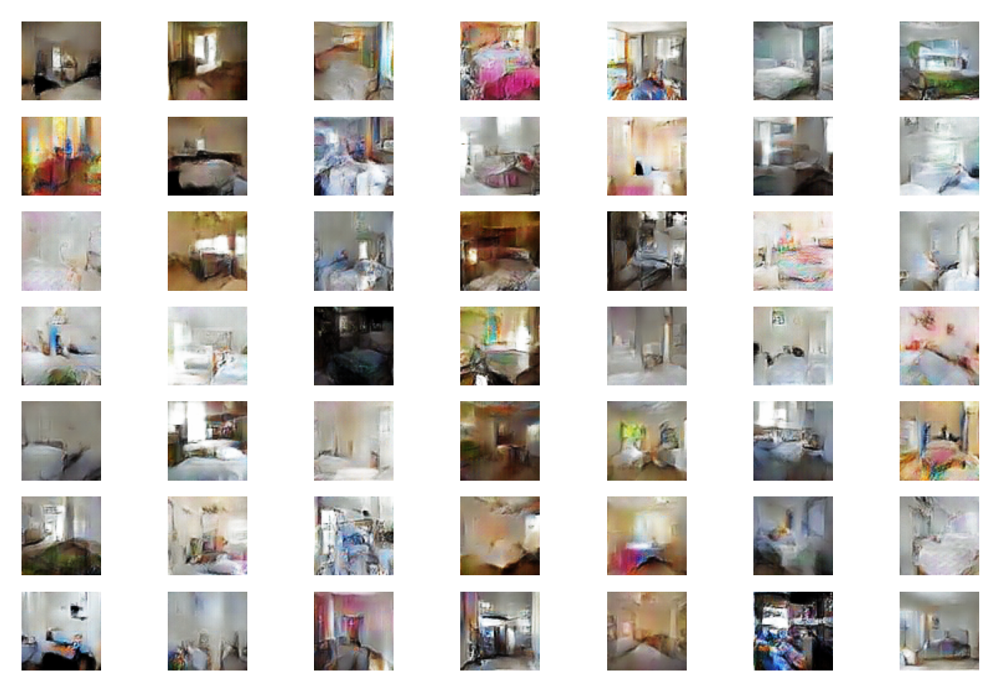

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


  0%|          | 0/2368 [00:00<?, ?it/s]

 Epoch: 10, Batch: 1 of 2368
 Discriminator real loss: 0.11376724392175674, Discriminator Fake loss: 0.19680604338645935, Generator loss: 3.3205084800720215
 Epoch: 10, Batch: 101 of 2368
 Discriminator real loss: 0.16948659718036652, Discriminator Fake loss: 0.14636516571044922, Generator loss: 3.4579758644104004
 Epoch: 10, Batch: 201 of 2368
 Discriminator real loss: 0.21094131469726562, Discriminator Fake loss: 0.19809243083000183, Generator loss: 3.334604263305664
 Epoch: 10, Batch: 301 of 2368
 Discriminator real loss: 0.2585621774196625, Discriminator Fake loss: 0.26371121406555176, Generator loss: 3.844916582107544
 Epoch: 10, Batch: 401 of 2368
 Discriminator real loss: 0.4261753559112549, Discriminator Fake loss: 0.05489803105592728, Generator loss: 4.023773193359375
 Epoch: 10, Batch: 501 of 2368
 Discriminator real loss: 0.19112840294837952, Discriminator Fake loss: 0.14100214838981628, Generator loss: 3.749040126800537
 Epoch: 10, Batch: 601 of 2368
 Discriminator real los

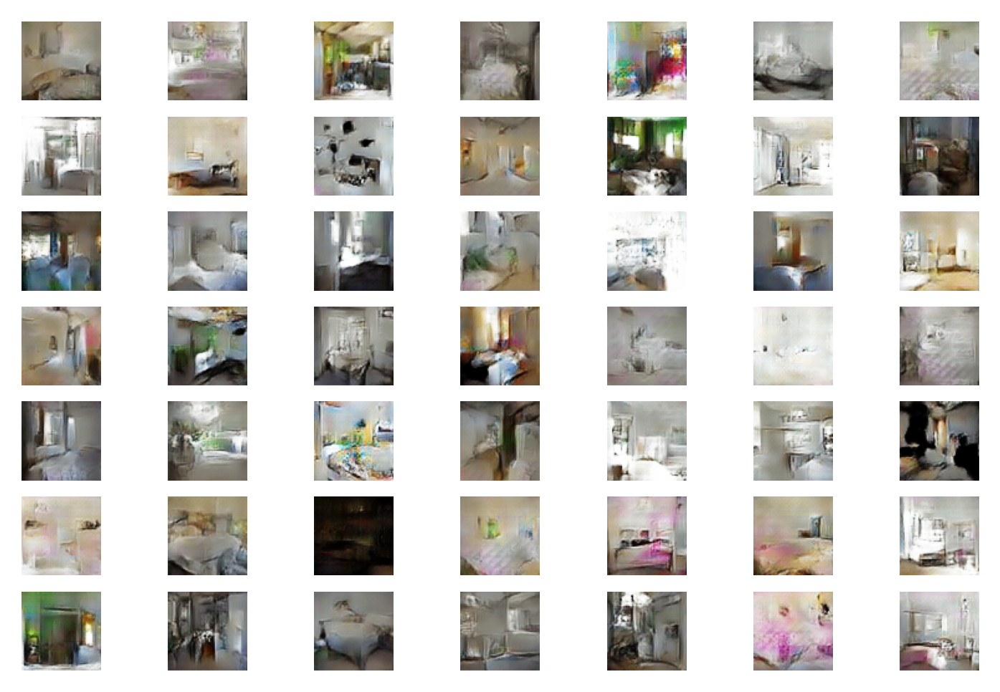

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k/discriminator/assets


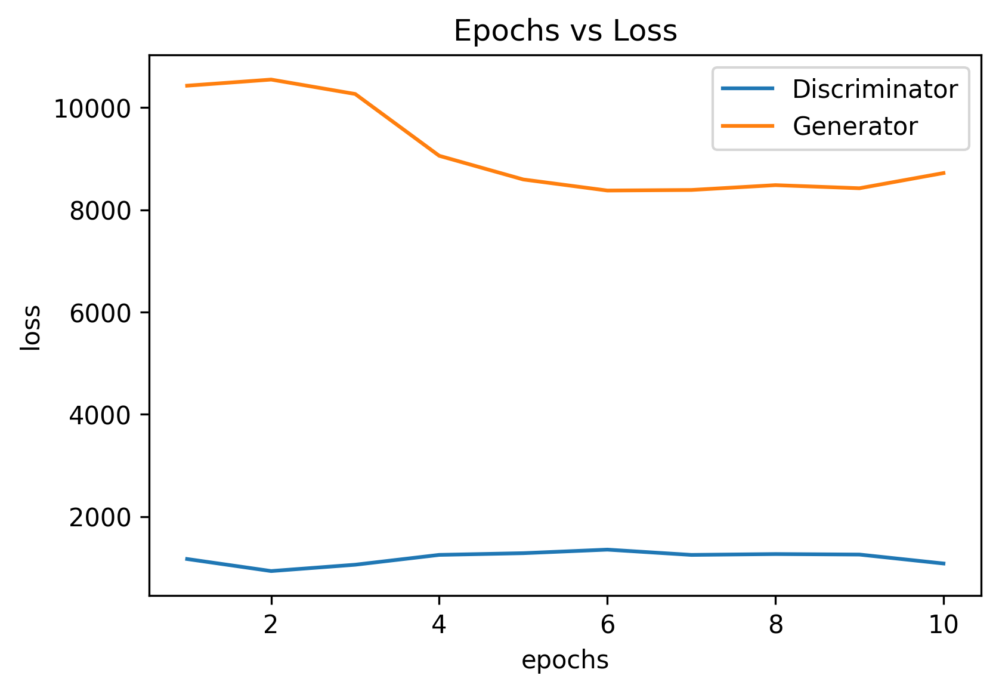

Done with training the model ......
CPU times: user 51min 42s, sys: 6min 34s, total: 58min 17s
Wall time: 2h 33min 35s


In [9]:
%%time
# size of the latent space
samplesize = 100


# create the discriminator
discriminator = discriminator_(
                               d_lr=0.0002,
                               d_beta=0.5)
# create the generator
generator = generator_(samplesize)
# create the gan
dcgan = dcgan_(generator, discriminator)

# train model
trained_generator = train(generator, discriminator, dcgan, X_train, samplesize, epochs=10, batch_size=128, model_name="DCGAN_lsun_nobn_300k")

##  Training on dataset of 303125 images

Number of images in the train set:  303125
shape of each image is : (64, 64, 3)
********************
Original Images
********************


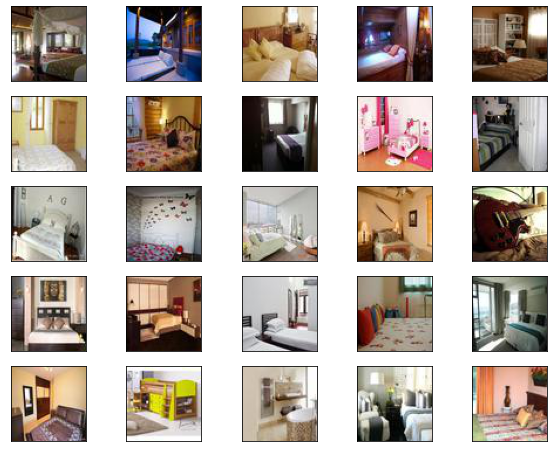

********************
After cropping & Reshaping
********************


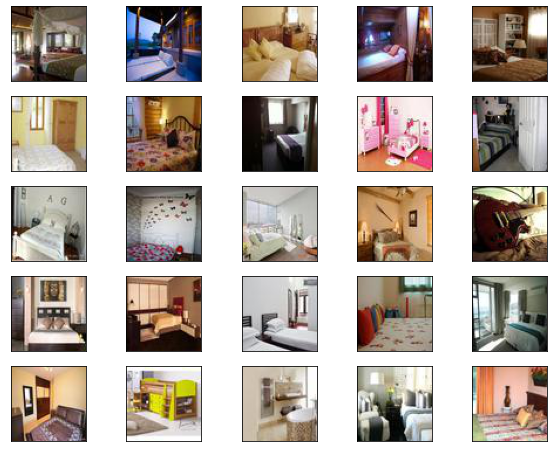

shape after cropping:  (64, 64, 3)


In [3]:
X_train = np.array(glob('data/lsun_10/data/lsun_imgs/*.jpg'))
print("Number of images in the train set: ", X_train.shape[0])
print("shape of each image is :", plt.imread(X_train[0]).shape)

print('*'*20)
print("Original Images")
print('*'*20)
plt.figure(figsize=(10, 8))
for i in range(25):
    image = plt.imread(X_train[i])
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(image)

plt.show()

print('*'*20)
print("After cropping & Reshaping")
print('*'*20)

plt.figure(figsize=(10, 8))
for i in range(25):
    image = image_loader(X_train[i], resize_to=(64, 64))
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(image)
plt.show()
print("shape after cropping: ", image.shape)






 Training DCGAN_lsun_nobn_300k_at2 ......


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 1, Batch: 1 of 18945
 Discriminator real loss: 0.6578395366668701, Discriminator Fake loss: 0.6972967982292175, Generator loss: 0.6897147297859192
 Epoch: 1, Batch: 101 of 18945
 Discriminator real loss: 0.31570738554000854, Discriminator Fake loss: 0.276652455329895, Generator loss: 3.4285457134246826
 Epoch: 1, Batch: 201 of 18945
 Discriminator real loss: 1.089536660255859e-18, Discriminator Fake loss: 0.021119708195328712, Generator loss: 4.527307510375977
 Epoch: 1, Batch: 301 of 18945
 Discriminator real loss: 1.225277304649353, Discriminator Fake loss: 0.06533712148666382, Generator loss: 2.466747283935547
 Epoch: 1, Batch: 401 of 18945
 Discriminator real loss: 2.548893451690674, Discriminator Fake loss: 0.1072738990187645, Generator loss: 3.5072996616363525
 Epoch: 1, Batch: 501 of 18945
 Discriminator real loss: 0.008746621198952198, Discriminator Fake loss: 0.0543132908642292, Generator loss: 3.815232038497925
 Epoch: 1, Batch: 601 of 18945
 Discriminator real loss: 

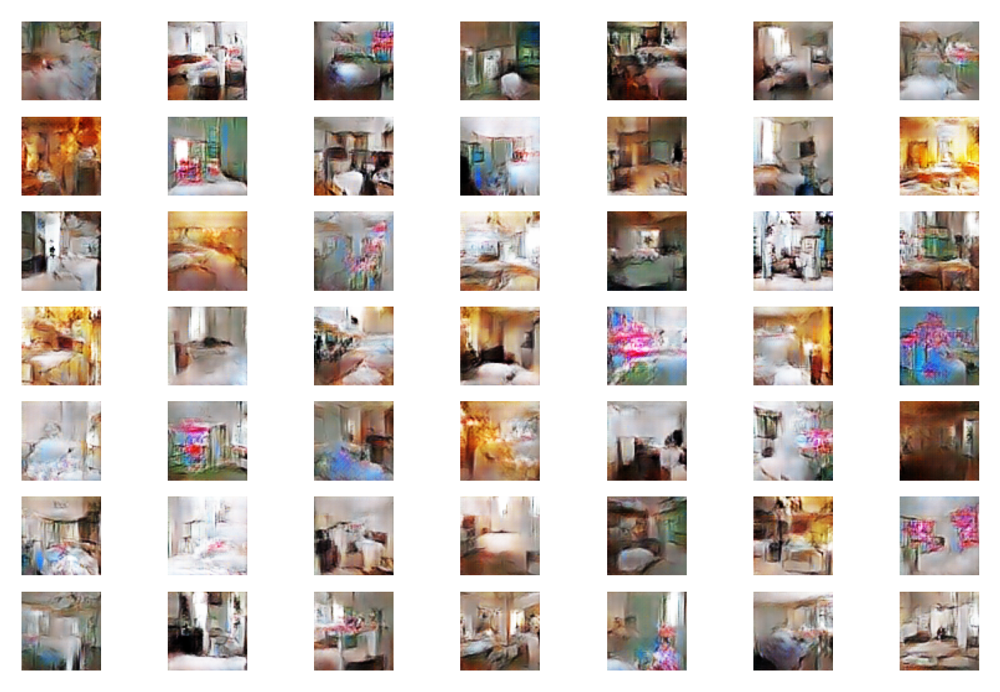

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 2, Batch: 1 of 18945
 Discriminator real loss: 0.2534710466861725, Discriminator Fake loss: 0.14883151650428772, Generator loss: 2.231856346130371
 Epoch: 2, Batch: 101 of 18945
 Discriminator real loss: 0.27468788623809814, Discriminator Fake loss: 0.14625179767608643, Generator loss: 3.908735990524292
 Epoch: 2, Batch: 201 of 18945
 Discriminator real loss: 0.021648265421390533, Discriminator Fake loss: 0.39881226420402527, Generator loss: 3.929910659790039
 Epoch: 2, Batch: 301 of 18945
 Discriminator real loss: 0.2297283262014389, Discriminator Fake loss: 0.2209075540304184, Generator loss: 2.9696414470672607
 Epoch: 2, Batch: 401 of 18945
 Discriminator real loss: 0.3887033462524414, Discriminator Fake loss: 0.11975494027137756, Generator loss: 2.063415050506592
 Epoch: 2, Batch: 501 of 18945
 Discriminator real loss: 0.14506053924560547, Discriminator Fake loss: 0.10343816876411438, Generator loss: 2.758620262145996
 Epoch: 2, Batch: 601 of 18945
 Discriminator real loss:

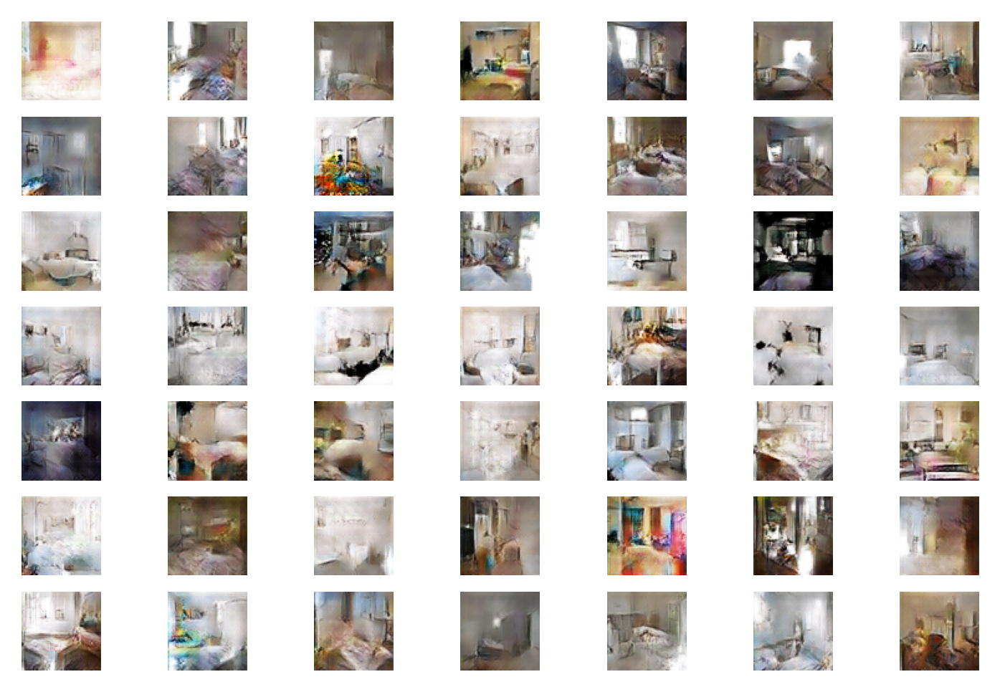

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 3, Batch: 1 of 18945
 Discriminator real loss: 0.19092591106891632, Discriminator Fake loss: 1.1269850730895996, Generator loss: 5.78973388671875
 Epoch: 3, Batch: 101 of 18945
 Discriminator real loss: 0.5211158990859985, Discriminator Fake loss: 0.08790276199579239, Generator loss: 3.11165452003479
 Epoch: 3, Batch: 201 of 18945
 Discriminator real loss: 0.024543676525354385, Discriminator Fake loss: 0.939984917640686, Generator loss: 3.728214740753174
 Epoch: 3, Batch: 301 of 18945
 Discriminator real loss: 0.5644559264183044, Discriminator Fake loss: 0.24430763721466064, Generator loss: 2.4829609394073486
 Epoch: 3, Batch: 401 of 18945
 Discriminator real loss: 0.11691424250602722, Discriminator Fake loss: 0.10921908915042877, Generator loss: 2.8273119926452637
 Epoch: 3, Batch: 501 of 18945
 Discriminator real loss: 0.015200452879071236, Discriminator Fake loss: 1.1173440217971802, Generator loss: 4.864152908325195
 Epoch: 3, Batch: 601 of 18945
 Discriminator real loss: 0

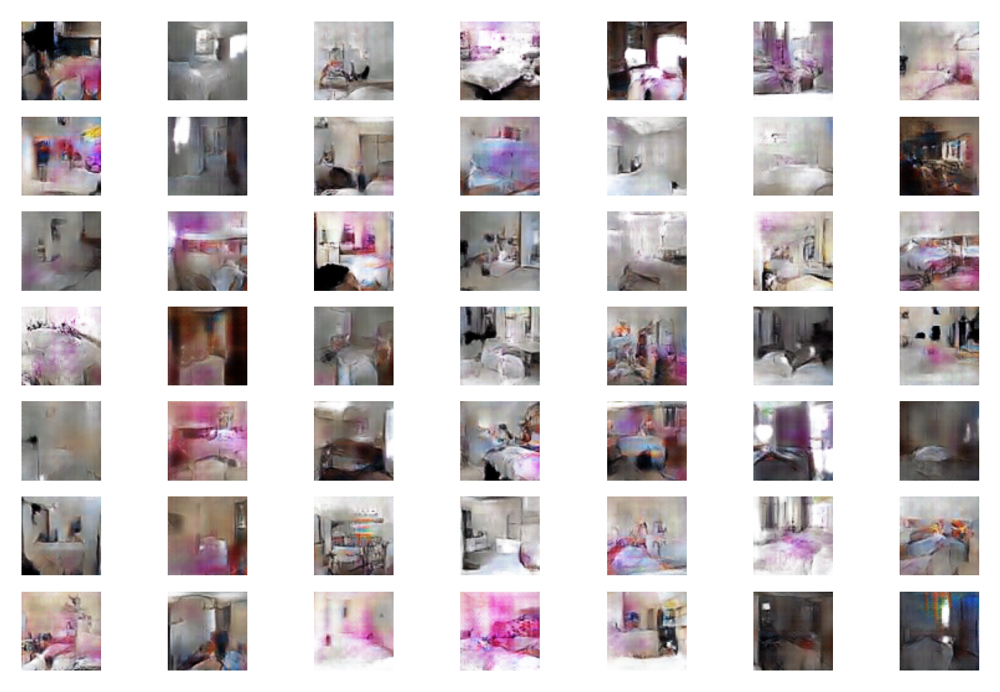

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 4, Batch: 1 of 18945
 Discriminator real loss: 0.12875546514987946, Discriminator Fake loss: 0.3407641351222992, Generator loss: 4.520134925842285
 Epoch: 4, Batch: 101 of 18945
 Discriminator real loss: 0.0002913827484007925, Discriminator Fake loss: 0.09822205454111099, Generator loss: 5.499046325683594
 Epoch: 4, Batch: 201 of 18945
 Discriminator real loss: 0.7786223888397217, Discriminator Fake loss: 0.15611913800239563, Generator loss: 3.8135452270507812
 Epoch: 4, Batch: 301 of 18945
 Discriminator real loss: 0.2990776598453522, Discriminator Fake loss: 0.03662596642971039, Generator loss: 3.547079086303711
 Epoch: 4, Batch: 401 of 18945
 Discriminator real loss: 0.007399220019578934, Discriminator Fake loss: 0.06985262781381607, Generator loss: 3.9392037391662598
 Epoch: 4, Batch: 501 of 18945
 Discriminator real loss: 0.21546070277690887, Discriminator Fake loss: 0.1820453554391861, Generator loss: 3.5162155628204346
 Epoch: 4, Batch: 601 of 18945
 Discriminator real l

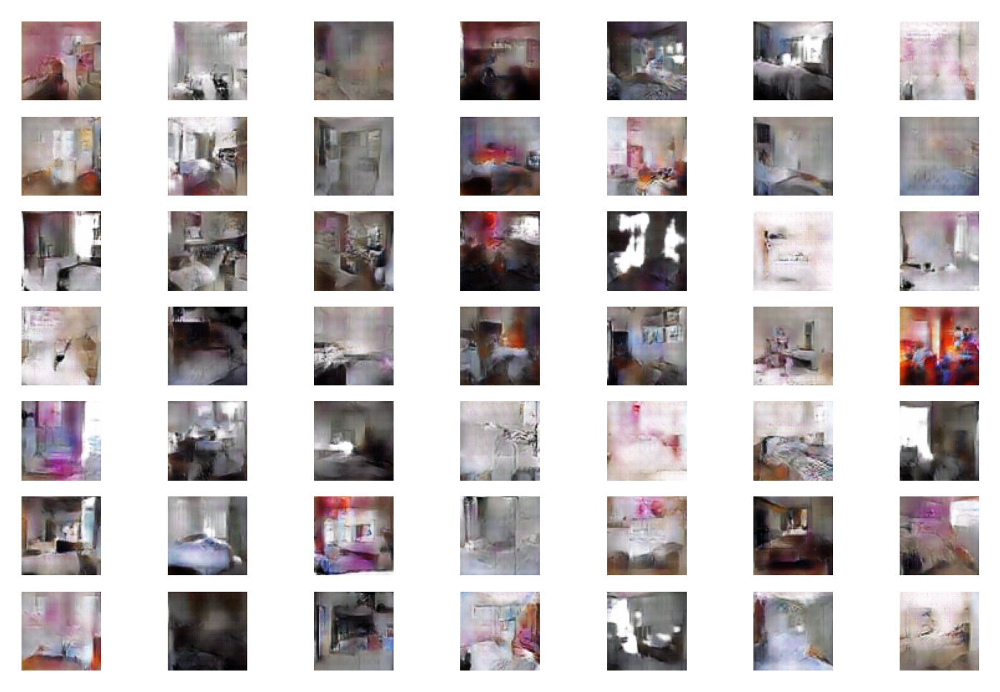

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 5, Batch: 1 of 18945
 Discriminator real loss: 0.1940455436706543, Discriminator Fake loss: 0.10992229729890823, Generator loss: 2.6282713413238525
 Epoch: 5, Batch: 101 of 18945
 Discriminator real loss: 0.7460048198699951, Discriminator Fake loss: 0.058786772191524506, Generator loss: 3.6241307258605957
 Epoch: 5, Batch: 201 of 18945
 Discriminator real loss: 0.027584124356508255, Discriminator Fake loss: 0.018027279525995255, Generator loss: 3.5990428924560547
 Epoch: 5, Batch: 301 of 18945
 Discriminator real loss: 0.27453798055648804, Discriminator Fake loss: 0.04123827815055847, Generator loss: 3.8318228721618652
 Epoch: 5, Batch: 401 of 18945
 Discriminator real loss: 0.027824314311146736, Discriminator Fake loss: 0.006345193833112717, Generator loss: 5.085892677307129
 Epoch: 5, Batch: 501 of 18945
 Discriminator real loss: 0.00016947605763562024, Discriminator Fake loss: 0.027418125420808792, Generator loss: 5.271861553192139
 Epoch: 5, Batch: 601 of 18945
 Discriminat

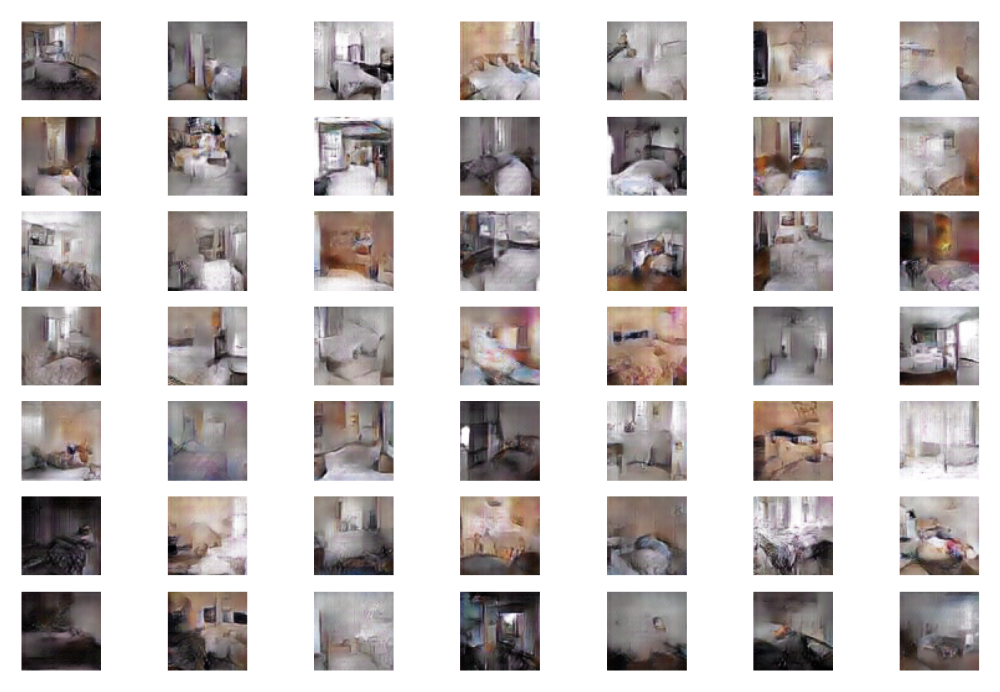

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 6, Batch: 1 of 18945
 Discriminator real loss: 0.08653761446475983, Discriminator Fake loss: 0.08510042726993561, Generator loss: 4.724423885345459
 Epoch: 6, Batch: 101 of 18945
 Discriminator real loss: 1.0077056685986463e-05, Discriminator Fake loss: 0.0005898505914956331, Generator loss: 9.088483810424805
 Epoch: 6, Batch: 201 of 18945
 Discriminator real loss: 0.03497941046953201, Discriminator Fake loss: 0.0009155652951449156, Generator loss: 8.75002384185791
 Epoch: 6, Batch: 301 of 18945
 Discriminator real loss: 0.0034590589348226786, Discriminator Fake loss: 0.014319857582449913, Generator loss: 5.962950706481934
 Epoch: 6, Batch: 401 of 18945
 Discriminator real loss: 0.0008602952002547681, Discriminator Fake loss: 0.015086829662322998, Generator loss: 4.056459426879883
 Epoch: 6, Batch: 501 of 18945
 Discriminator real loss: 0.003584669204428792, Discriminator Fake loss: 0.00629868870601058, Generator loss: 5.197867393493652
 Epoch: 6, Batch: 601 of 18945
 Discrimin

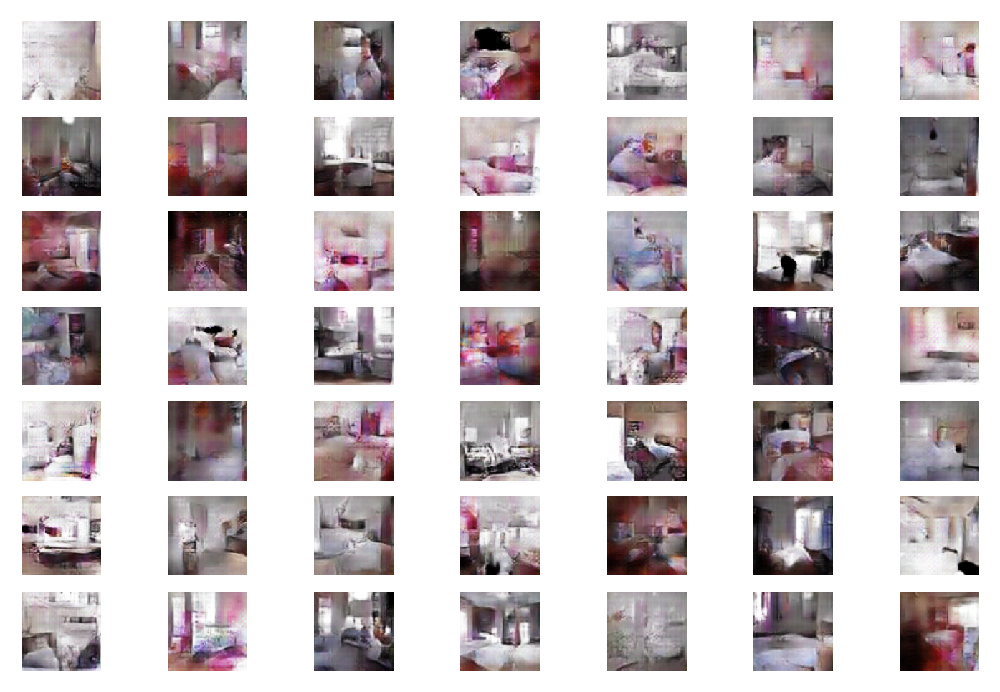

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 7, Batch: 1 of 18945
 Discriminator real loss: 0.0446857288479805, Discriminator Fake loss: 0.013794207014143467, Generator loss: 6.843266487121582
 Epoch: 7, Batch: 101 of 18945
 Discriminator real loss: 0.19829314947128296, Discriminator Fake loss: 0.01951231248676777, Generator loss: 4.707847595214844
 Epoch: 7, Batch: 201 of 18945
 Discriminator real loss: 0.008002727292478085, Discriminator Fake loss: 0.8596853017807007, Generator loss: 7.531707286834717
 Epoch: 7, Batch: 301 of 18945
 Discriminator real loss: 1.0561996077740332e-06, Discriminator Fake loss: 0.006714970804750919, Generator loss: 6.279519557952881
 Epoch: 7, Batch: 401 of 18945
 Discriminator real loss: 0.0020473955664783716, Discriminator Fake loss: 0.000534857390448451, Generator loss: 7.16429328918457
 Epoch: 7, Batch: 501 of 18945
 Discriminator real loss: 0.026533275842666626, Discriminator Fake loss: 0.004434067755937576, Generator loss: 5.382471084594727
 Epoch: 7, Batch: 601 of 18945
 Discriminator 

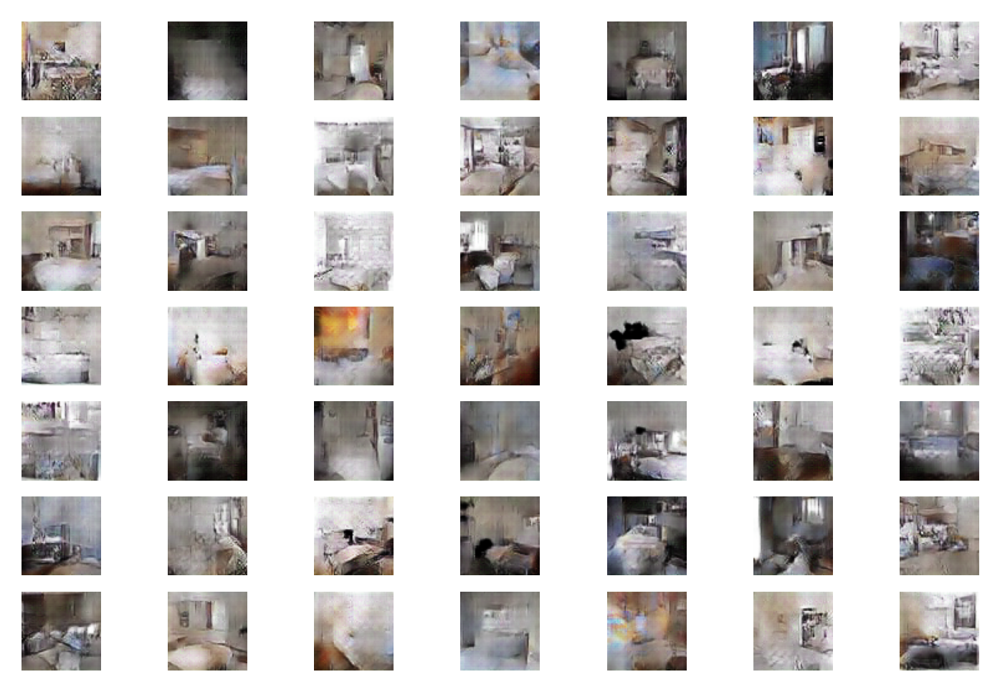

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 8, Batch: 1 of 18945
 Discriminator real loss: 0.05993066728115082, Discriminator Fake loss: 0.011623763479292393, Generator loss: 5.155848503112793
 Epoch: 8, Batch: 101 of 18945
 Discriminator real loss: 0.0023508730810135603, Discriminator Fake loss: 0.033247821033000946, Generator loss: 5.754047870635986
 Epoch: 8, Batch: 201 of 18945
 Discriminator real loss: 0.24940034747123718, Discriminator Fake loss: 0.0659850463271141, Generator loss: 3.5650579929351807
 Epoch: 8, Batch: 301 of 18945
 Discriminator real loss: 0.002517257584258914, Discriminator Fake loss: 0.004992353264242411, Generator loss: 7.806852340698242
 Epoch: 8, Batch: 401 of 18945
 Discriminator real loss: 0.03679443150758743, Discriminator Fake loss: 0.046988777816295624, Generator loss: 5.6153178215026855
 Epoch: 8, Batch: 501 of 18945
 Discriminator real loss: 0.004459196701645851, Discriminator Fake loss: 0.401748925447464, Generator loss: 6.475319862365723
 Epoch: 8, Batch: 601 of 18945
 Discriminator r

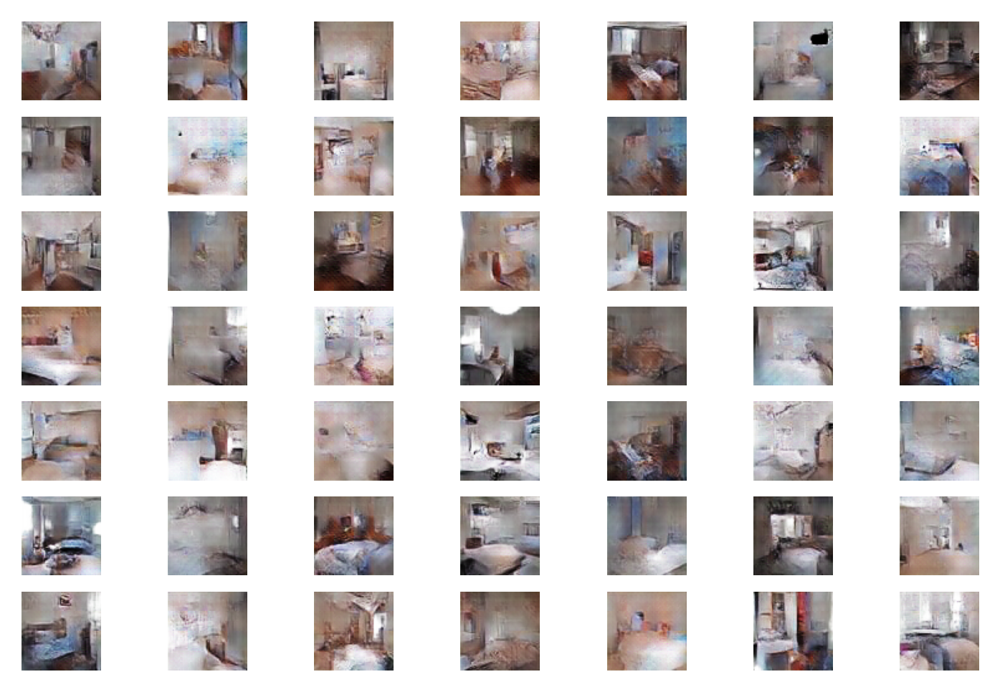

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 9, Batch: 1 of 18945
 Discriminator real loss: 0.049454521387815475, Discriminator Fake loss: 0.0025616255588829517, Generator loss: 6.785361289978027
 Epoch: 9, Batch: 101 of 18945
 Discriminator real loss: 0.29123926162719727, Discriminator Fake loss: 0.00976682361215353, Generator loss: 6.1238322257995605
 Epoch: 9, Batch: 201 of 18945
 Discriminator real loss: 0.009689164347946644, Discriminator Fake loss: 0.5773192048072815, Generator loss: 6.9744768142700195
 Epoch: 9, Batch: 301 of 18945
 Discriminator real loss: 9.383647011418361e-06, Discriminator Fake loss: 0.0030853396747261286, Generator loss: 6.660846710205078
 Epoch: 9, Batch: 401 of 18945
 Discriminator real loss: 0.01548684947192669, Discriminator Fake loss: 0.00813696812838316, Generator loss: 6.040509223937988
 Epoch: 9, Batch: 501 of 18945
 Discriminator real loss: 0.0002589763898868114, Discriminator Fake loss: 0.12763752043247223, Generator loss: 4.538853168487549
 Epoch: 9, Batch: 601 of 18945
 Discriminat

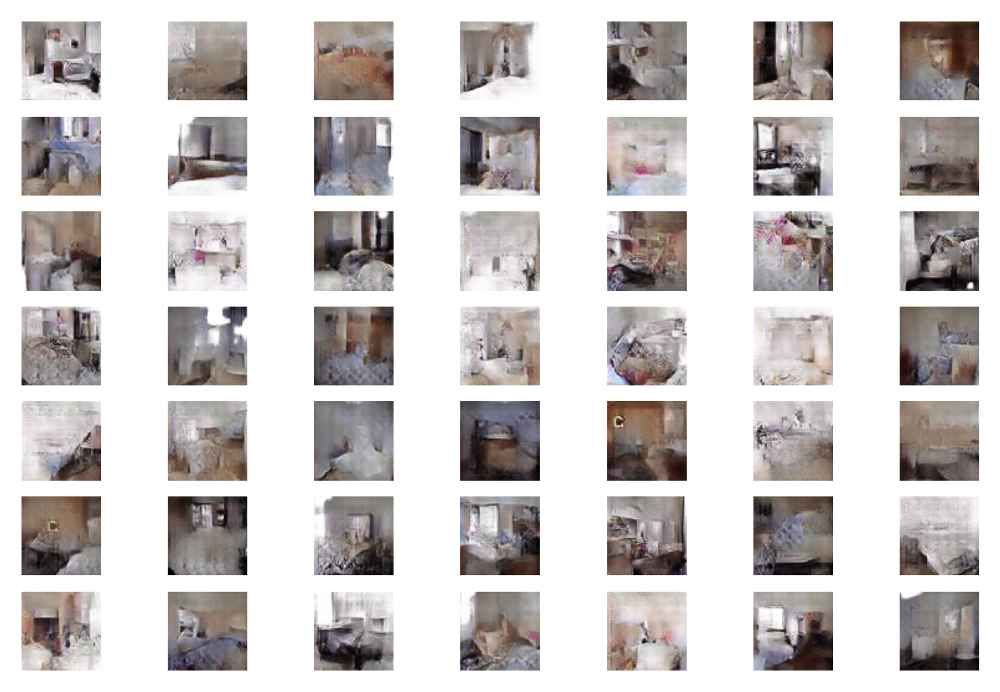

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


  0%|          | 0/18945 [00:00<?, ?it/s]

 Epoch: 10, Batch: 1 of 18945
 Discriminator real loss: 0.05358860641717911, Discriminator Fake loss: 0.023695705458521843, Generator loss: 4.0634918212890625
 Epoch: 10, Batch: 101 of 18945
 Discriminator real loss: 0.12482720613479614, Discriminator Fake loss: 0.012776317074894905, Generator loss: 4.460302829742432
 Epoch: 10, Batch: 201 of 18945
 Discriminator real loss: 7.90139256423572e-06, Discriminator Fake loss: 0.0005020872340537608, Generator loss: 10.725776672363281
 Epoch: 10, Batch: 301 of 18945
 Discriminator real loss: 5.326708318875717e-08, Discriminator Fake loss: 0.04740504175424576, Generator loss: 4.213962078094482
 Epoch: 10, Batch: 401 of 18945
 Discriminator real loss: 0.0020686283241957426, Discriminator Fake loss: 0.009543091058731079, Generator loss: 6.287585258483887
 Epoch: 10, Batch: 501 of 18945
 Discriminator real loss: 0.04833485186100006, Discriminator Fake loss: 0.05431937053799629, Generator loss: 6.484706401824951
 Epoch: 10, Batch: 601 of 18945
 Dis

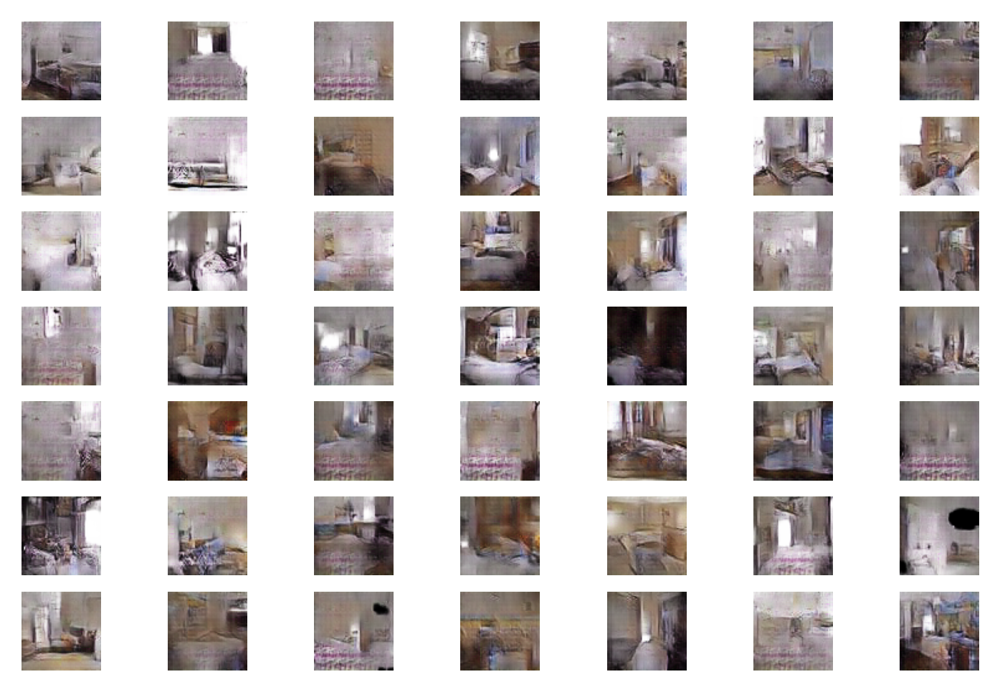

INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/generator/assets
INFO:tensorflow:Assets written to: trained_models/DCGAN_lsun_nobn_300k_at2/discriminator/assets


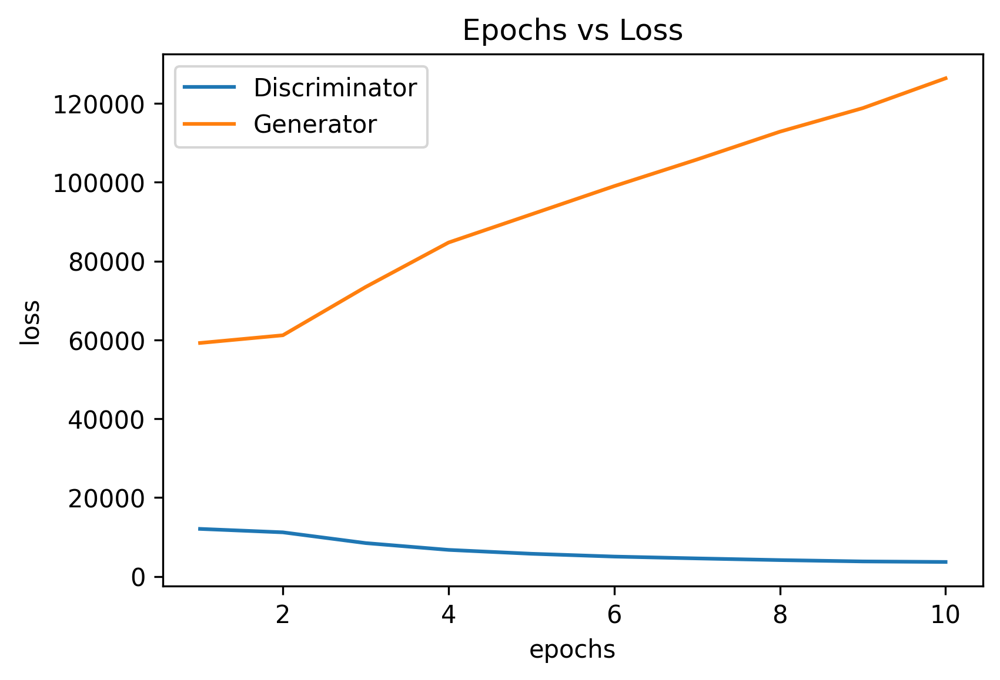

Done with training the model ......
CPU times: user 3h 33min 27s, sys: 17min 25s, total: 3h 50min 53s
Wall time: 5h 43min 17s


In [4]:
%%time
# size of the latent space
samplesize = 100


# create the discriminator
discriminator = discriminator_(
                               d_lr=0.0002,
                               d_beta=0.5)
# create the generator
generator = generator_(samplesize)
# create the gan
dcgan = dcgan_(generator, discriminator)

# train model
trained_generator = train(generator, discriminator, dcgan, X_train, samplesize, epochs=10, batch_size=16, model_name="DCGAN_lsun_nobn_300k_at2")

In [5]:
# Generating video of images generated in all epochs

generate_video("DCGAN_lsun_nobn_300k_at2")

Epoch evolutions video saved as results/DCGAN_lsun_nobn_300k_at2/outputs_evolution.avi
